<table align="center">
  <tr>
    <td><img src="https://media.giphy.com/media/v1.Y2lkPTc5MGI3NjExMXFkNzFyZWZiYnV6cDYxeTl4ZWpneHNrc2Nlc3NhOGdwYmNhY2NqeCZlcD12MV9zdGlja2Vyc19zZWFyY2gmY3Q9cw/jRVKyH598vSxajcK8R/giphy.gif" width="450"/></td>
    <td>
      <h1 style="font-size:60px; text-align:center; color:blue;">
        🔵 Analyzing Airline Passenger Satisfaction 🔴
      </h1>
    </td>
    <td><img src="https://media.giphy.com/media/v1.Y2lkPWVjZjA1ZTQ3cThlOGt6cGNmaTY4bjlieGs2bXd5dmU2dTRjbTRxYWt5dzBncG1tayZlcD12MV9zdGlja2Vyc19zZWFyY2gmY3Q9cw/QHWgUzne74AOvKFvrR/giphy.gif" width="300"/></td>
  </tr>
</table>


<h2 align="center">🗂️📊🧹 Dataset Setup & Preprocessing</h2>

In [31]:
#!pip install ydata_profiling
import pandas as pd
from ydata_profiling import ProfileReport

In [32]:
df=pd.read_csv(r"/content/airline_passenger_satisfaction.csv")
profile=ProfileReport(df,title="Profiling Report", progress_bar=False)
profile.to_file(output_file="Airline Passenger Satisfaction.html")
profile

100%|██████████| 24/24 [00:02<00:00,  9.75it/s]


In [33]:
df.head()

,ID,Gender,Age,Customer Type,Type of Travel,Class,Flight Distance,Departure Delay,Arrival Delay,Departure and Arrival Time Convenience,...,On-board Service,Seat Comfort,Leg Room Service,Cleanliness,Food and Drink,In-flight Service,In-flight Wifi Service,In-flight Entertainment,Baggage Handling,Satisfaction
0,1,Male,48,First-time,Business,Business,821,2,5.0,3,...,3,5,2,5,5,5,3,5,5,Neutral or Dissatisfied
1,2,Female,35,Returning,Business,Business,821,26,39.0,2,...,5,4,5,5,3,5,2,5,5,Satisfied
2,3,Male,41,Returning,Business,Business,853,0,0.0,4,...,3,5,3,5,5,3,4,3,3,Satisfied
3,4,Male,50,Returning,Business,Business,1905,0,0.0,2,...,5,5,5,4,4,5,2,5,5,Satisfied
4,5,Female,49,Returning,Business,Business,3470,0,1.0,3,...,3,4,4,5,4,3,3,3,3,Satisfied


In [34]:
display(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   ID                                      129880 non-null  int64  
 1   Gender                                  129880 non-null  object 
 2   Age                                     129880 non-null  int64  
 3   Customer Type                           129880 non-null  object 
 4   Type of Travel                          129880 non-null  object 
 5   Class                                   129880 non-null  object 
 6   Flight Distance                         129880 non-null  int64  
 7   Departure Delay                         129880 non-null  int64  
 8   Arrival Delay                           129487 non-null  float64
 9   Departure and Arrival Time Convenience  129880 non-null  int64  
 10  Ease of Online Booking                  1298

None

In [35]:
df.shape

(129880, 24)

In [36]:
from IPython.display import display, HTML

display(df.describe().style.format('{:.2f}'))
display(HTML("<br><br><br>"))
display(df.describe(include='object'))

,ID,Age,Flight Distance,Departure Delay,Arrival Delay,Departure and Arrival Time Convenience,Ease of Online Booking,Check-in Service,Online Boarding,Gate Location,On-board Service,Seat Comfort,Leg Room Service,Cleanliness,Food and Drink,In-flight Service,In-flight Wifi Service,In-flight Entertainment,Baggage Handling
count,129880.00,129880.00,129880.00,129880.00,129487.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00,129880.00
mean,64940.50,39.43,1190.32,14.71,15.09,3.06,2.76,3.31,3.25,2.98,3.38,3.44,3.35,3.29,3.20,3.64,2.73,3.36,3.63
std,37493.27,15.12,997.45,38.07,38.47,1.53,1.40,1.27,1.35,1.28,1.29,1.32,1.32,1.31,1.33,1.18,1.33,1.33,1.18
min,1.00,7.00,31.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00
25%,32470.75,27.00,414.00,0.00,0.00,2.00,2.00,3.00,2.00,2.00,2.00,2.00,2.00,2.00,2.00,3.00,2.00,2.00,3.00
50%,64940.50,40.00,844.00,0.00,0.00,3.00,3.00,3.00,3.00,3.00,4.00,4.00,4.00,3.00,3.00,4.00,3.00,4.00,4.00
75%,97410.25,51.00,1744.00,12.00,13.00,4.00,4.00,4.00,4.00,4.00,4.00,5.00,4.00,4.00,4.00,5.00,4.00,4.00,5.00
max,129880.00,85.00,4983.00,1592.00,1584.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00


,Gender,Customer Type,Type of Travel,Class,Satisfaction
count,129880,129880,129880,129880,129880
unique,2,2,2,3,2
top,Female,Returning,Business,Business,Neutral or Dissatisfied
freq,65899,106100,89693,62160,73452


In [37]:
import warnings
warnings.filterwarnings("ignore")

df.columns=df.columns.str.lower()
df.columns=df.columns.str.replace(" ","_")
df.columns

Index(['id', 'gender', 'age', 'customer_type', 'type_of_travel', 'class',
       'flight_distance', 'departure_delay', 'arrival_delay',
       'departure_and_arrival_time_convenience', 'ease_of_online_booking',
       'check-in_service', 'online_boarding', 'gate_location',
       'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
       'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
       'in-flight_entertainment', 'baggage_handling', 'satisfaction'],
      dtype='object')

In [38]:
df= df.drop('id', axis=1)
df.sample()

,gender,age,customer_type,type_of_travel,class,flight_distance,departure_delay,arrival_delay,departure_and_arrival_time_convenience,ease_of_online_booking,...,on-board_service,seat_comfort,leg_room_service,cleanliness,food_and_drink,in-flight_service,in-flight_wifi_service,in-flight_entertainment,baggage_handling,satisfaction
92818,Female,60,Returning,Business,Business,1587,7,0.0,5,5,...,2,4,2,3,1,2,2,2,2,Neutral or Dissatisfied


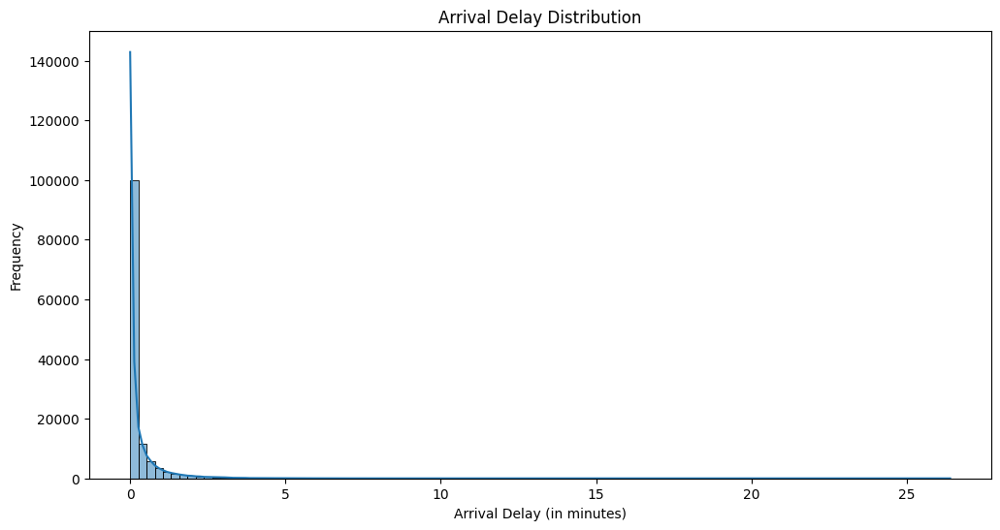

In [39]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

plt.figure(figsize=(12, 6))
# Use fewer bins for a broader view and potentially set x-axis limit
sns.histplot(df['arrival_delay']/60, bins=100, kde=True) # Increased bins to potentially show more detail
plt.title('Arrival Delay Distribution')
plt.xlabel('Arrival Delay (in minutes)')
plt.ylabel('Frequency')
# Optional: Set xlim to focus on a specific range if needed, e.g., plt.xlim(-10, 200)
plt.show()

In [40]:
df['arrival_delay'].median()

0.0

filling missing values with either **0** or the **median** will result in the same outcome because the median of this column **'arrival_delay'** is **0**

In [41]:
df['arrival_delay'].fillna(0, inplace=True)
df['arrival_delay'].isnull().sum()

np.int64(0)

<h2 align="center">🔍📈1️⃣ Univariate Analysis</h2>


In [42]:
df.columns

Index(['gender', 'age', 'customer_type', 'type_of_travel', 'class',
       'flight_distance', 'departure_delay', 'arrival_delay',
       'departure_and_arrival_time_convenience', 'ease_of_online_booking',
       'check-in_service', 'online_boarding', 'gate_location',
       'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
       'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
       'in-flight_entertainment', 'baggage_handling', 'satisfaction'],
      dtype='object')

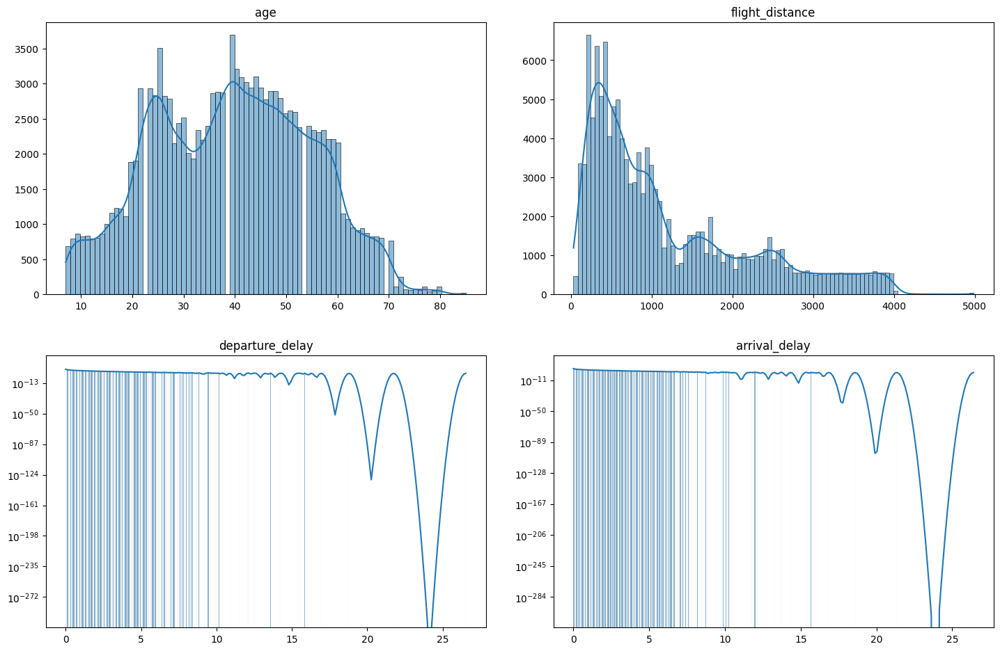

In [43]:
import math
import matplotlib.pyplot as plt
import seaborn as sns

# Define service columns to exclude, including convenience and online booking
service_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling',
    'departure_and_arrival_time_convenience', 'ease_of_online_booking' # Added these two columns
]

# Get numerical columns excluding satisfaction and service columns
other_columns = [col for col in df.columns if col != 'satisfaction' and col not in service_columns]
numerical_cols = df[other_columns].select_dtypes(include=['int64', 'float64']).columns

# تحديد عدد الصفوف والأعمدة للرسوم البيانية
n_cols = 2  # تغيير عدد الأعمدة إلى 2
n_rows = math.ceil(len(numerical_cols) / n_cols) # حساب عدد الصفوف بناءً على عدد الأعمدة

#generating histplots for numerical columns
plt.figure(figsize=(15, n_rows * 5)) # زيادة حجم الشكل
for i, col in enumerate(numerical_cols):
    plt.subplot(n_rows, n_cols, i + 1) # تعديل تخطيط الرسوم البيانية

    # Convert delay columns to minutes if they are departure or arrival delay
    if col in ['departure_delay', 'arrival_delay']:
        sns.histplot(df[col] / 60, kde=True)
        plt.xlabel(f'{col.replace("_", " ").title()} (in minutes)') # Add units to x-axis label
        plt.yscale('log')
        plt.ylabel('Frequency (Log Scale)')
    else:
        sns.histplot(df[col], kde=True)
        plt.xlabel(col.replace("_", " ").title())
        plt.ylabel("")


    plt.title(col)
    plt.xlabel("")
    plt.ylabel("")


plt.tight_layout(pad=3) # زيادة المسافة بين الرسوم البيانية
plt.show()

## 📊 Insights from Numerical Columns

- 👥 **Age**: Bimodal distribution → peaks at late 20s & late 40s/early 50s → two main passenger groups.  
- ✈️ **Flight Distance**: Skewed towards **short-haul flights**, with a long tail for longer distances.  
- ⏱️ **Departure & Arrival Delays**:  
  - Majority at **0 delay**.  
  - For delayed flights → skewed to **shorter delays**, fewer with long delays.   

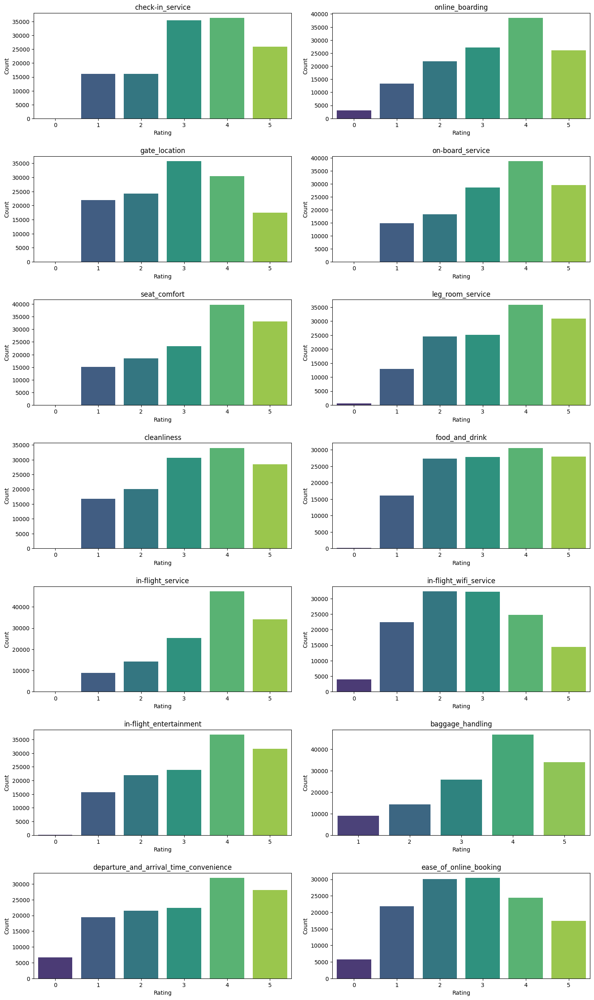

In [44]:
import matplotlib.pyplot as plt
import seaborn as sns

service_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling',
    'departure_and_arrival_time_convenience', # Added convenience column
    'ease_of_online_booking' # Added online booking column
]

plt.figure(figsize=(15, 25)) # Increased figure size to accommodate more plots

for index, col in enumerate(service_columns):
    plt.subplot((len(service_columns) + 1) // 2, 2, index + 1)

    sns.countplot(x=col, data=df, palette="viridis")

    plt.title(col)
    plt.xlabel("Rating")
    plt.ylabel("Count")

plt.tight_layout(pad=2)
plt.show()

## ✨ Insights from Service-Related Columns

- 👍 **Consistent High Ratings**: On-board Service, Seat Comfort, Leg Room Service, Cleanliness, Food & Drink, In-flight Service, Entertainment, Baggage Handling → mostly rated **4–5**.  
- ⚖️ **Variable Experiences**: Check-in Service & Gate Location → spread across **3–5**, less consistent.  
- 📶 **Weakness**: In-flight Wifi Service → many low ratings **(0–2)** → clear area for improvement.  
- 🚪 **Positive**: Online Boarding → majority **4–5**, smooth experience.  
- 🕒 **Time & Booking**:  
  - Departure & Arrival Time Convenience → mixed, mostly **3–5**.  
  - Ease of Online Booking → more **4–5**, better received than time convenience.  

➡️ **Overall**: Most services score well ✅, with **Wifi needing the most attention**, and **Check-in & Gate Location** showing room for improvement.


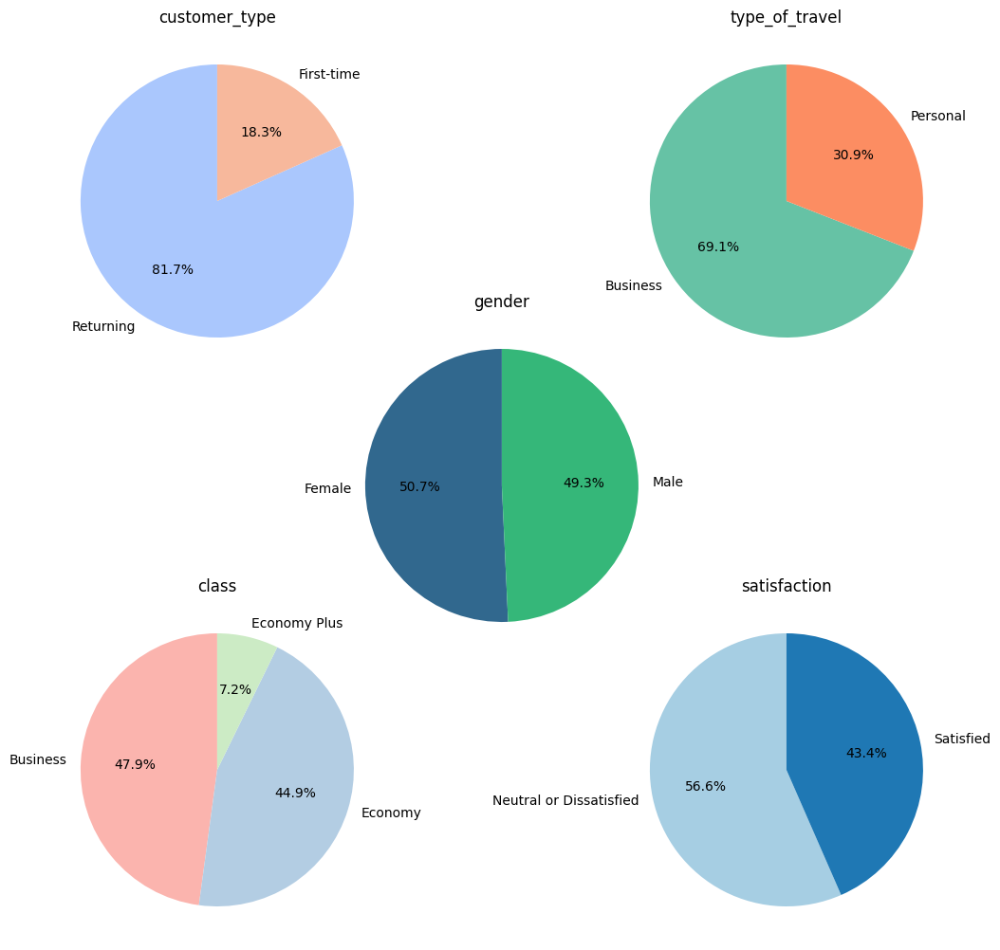

In [45]:
import matplotlib.pyplot as plt
import seaborn as sns

plot_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
palettes = ["viridis", "coolwarm", "Set2", "Pastel1", "Paired"]

fig = plt.figure(figsize=(20, 12))  # حجم أصغر عشان الأقراص أقرب

# مواقع الأقراص (قريبة من بعض)
positions = {
    0: (0.35, 0.35),  # المنتصف
    1: (0.2, 0.6),
    2: (0.5, 0.6),
    3: (0.2, 0.1),
    4: (0.5, 0.1)
}

for i, col in enumerate(plot_cols[:5]):
    x, y = positions[i]
    ax = fig.add_axes([x, y, 0.3, 0.3])  # حجم أكبر عشان الأقراص تلمس بعضها تقريبًا
    palette = sns.color_palette(palettes[i % len(palettes)], n_colors=len(df[col].unique()))
    df[col].value_counts().plot.pie(
        autopct='%1.1f%%',
        ax=ax,
        startangle=90,
        colors=palette
    )
    ax.set_ylabel("")
    ax.set_title(col, fontsize=12)

plt.show()


## 🥧 Insights from Categorical Columns (Pie Charts)

- 👥 **Customer Type**: Mostly **Returning customers**, fewer **First-time customers**.  
- 💼 **Type of Travel**: **Business travel** dominates over Personal travel.  
- 🚻 **Gender**: Nearly balanced between **Female** and **Male**.  
- 🛫 **Class**: **Business class** most common → then **Economy**, smaller share for **Economy Plus**.  
- 🙂😐 **Satisfaction**: Majority are **Neutral/Dissatisfied** → overall satisfaction needs improvement.  


<h2 align="center">🔗📊2️⃣ Bivariate Analysis</h2>


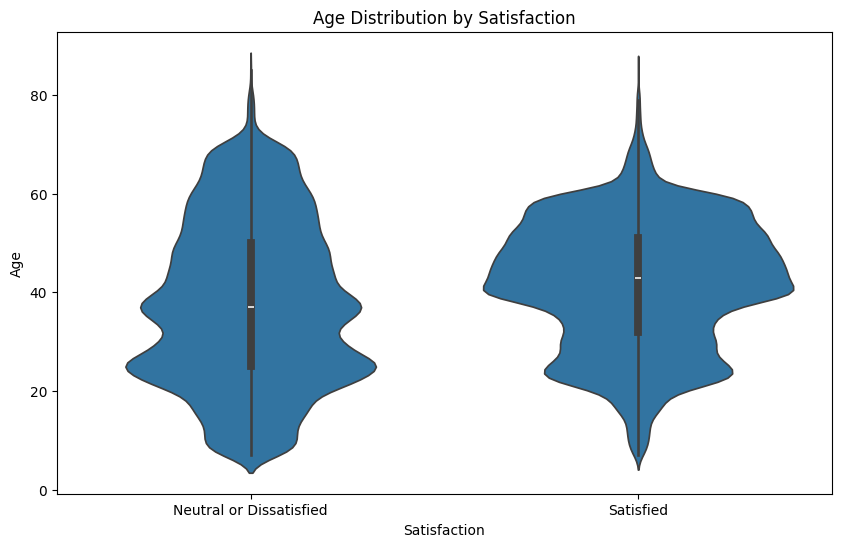

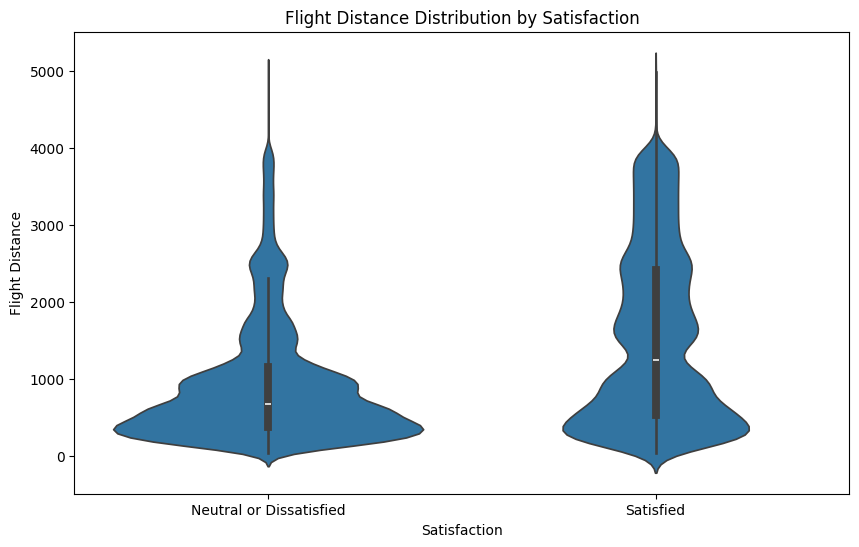

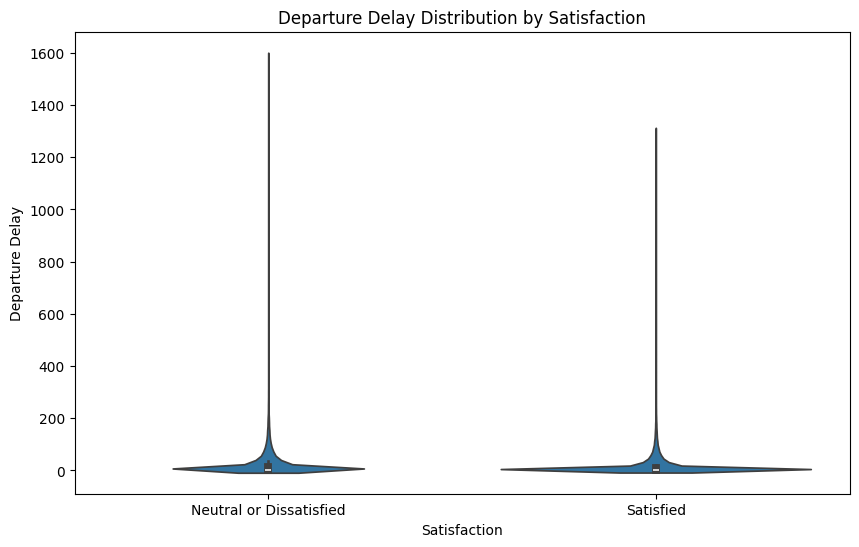

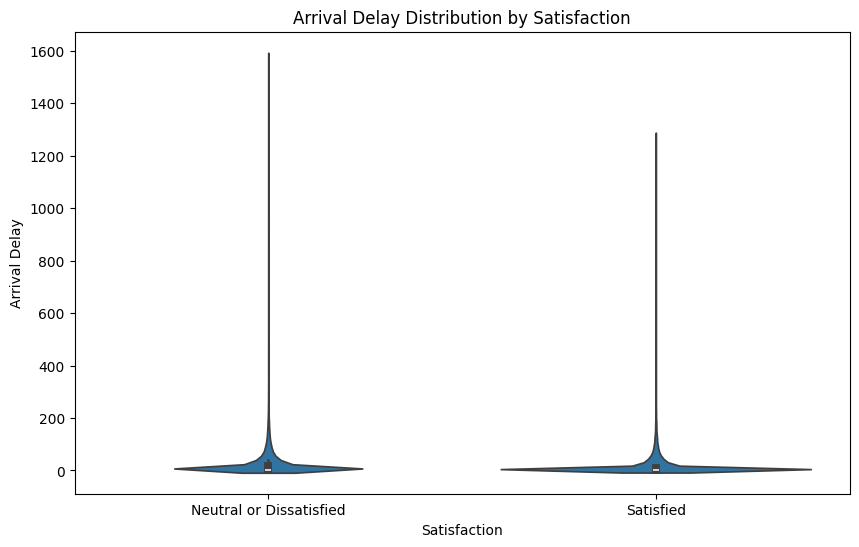

In [46]:
import matplotlib.pyplot as plt
import seaborn as sns

numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()

# Define service columns to exclude from this visualization
service_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling',
    'departure_and_arrival_time_convenience', 'ease_of_online_booking'
]

# Remove service columns and satisfaction from the list of numerical columns to plot against
cols_to_plot = [col for col in numerical_cols if col not in service_columns and col != 'satisfaction']


# Generate violin plots for numerical columns vs. satisfaction
for col in cols_to_plot:
    plt.figure(figsize=(10, 6))
    sns.violinplot(x='satisfaction', y=col, data=df)
    plt.title(f'{col.replace("_", " ").title()} Distribution by Satisfaction')
    plt.xlabel('Satisfaction')
    plt.ylabel(col.replace("_", " ").title())
    plt.show()

## 🎻 Insights from Violin Plots (Bivariate Analysis)

- 👥 **Age**:  
  - Satisfied passengers → skewed slightly towards **older age groups**.  
  - Neutral/Dissatisfied → more peak in **younger adults**.  

- ✈️ **Flight Distance**:  
  - Satisfied passengers → higher share of **longer flights**.  
  - Neutral/Dissatisfied → concentrated in **shorter flights**.  

- ⏱️ **Departure & Arrival Delays**:  
  - Both groups → high density at **0 delay** (most flights on time).  
  - For delayed flights → distributions differ slightly, with **longer delays present in both groups**, possibly more in dissatisfied passengers.  

➡️ **Key Takeaway**:  
Passenger **age** and especially **flight distance** may influence satisfaction more clearly than delays.


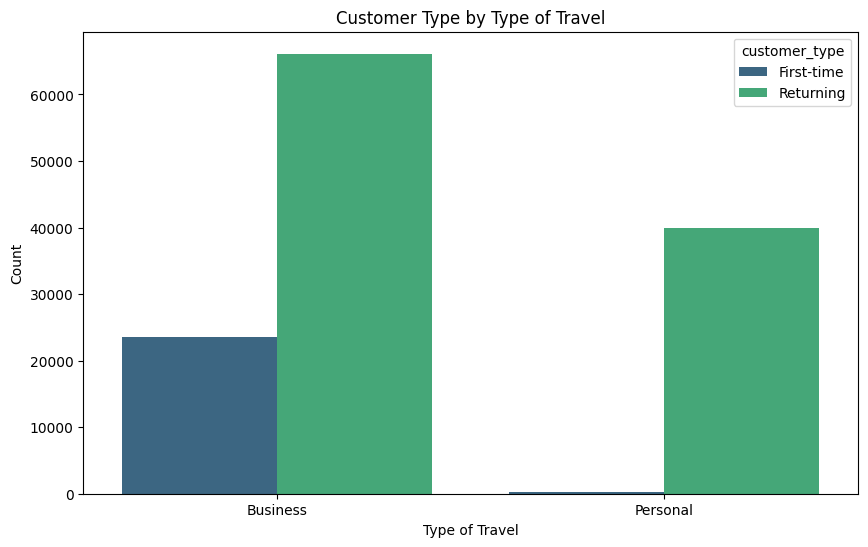

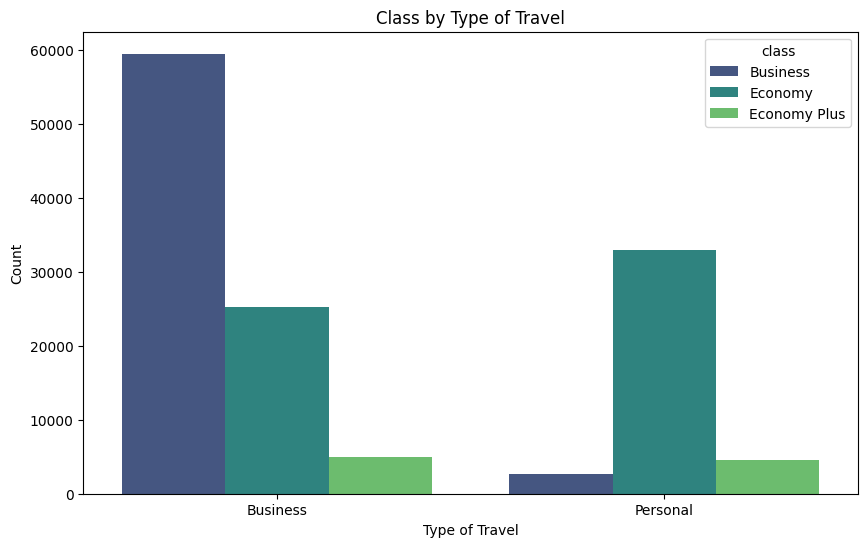

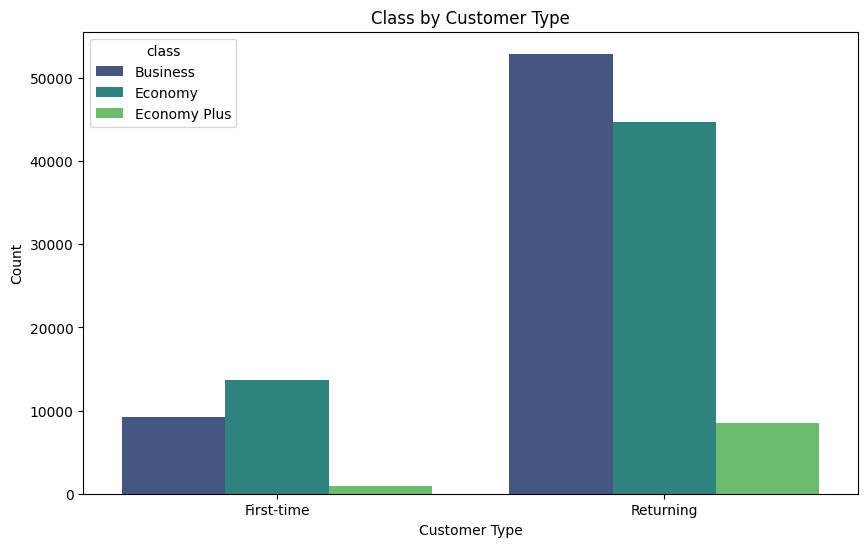

In [47]:
import matplotlib.pyplot as plt
import seaborn as sns

group_cols = ['gender', 'customer_type', 'type_of_travel', 'class']

# Compare Customer Type by Type of Travel
plt.figure(figsize=(10, 6))
sns.countplot(x='type_of_travel', hue='customer_type', data=df, palette='viridis')
plt.title('Customer Type by Type of Travel')
plt.xlabel('Type of Travel')
plt.ylabel('Count')
plt.show()

# Compare Class by Type of Travel
plt.figure(figsize=(10, 6))
sns.countplot(x='type_of_travel', hue='class', data=df, palette='viridis')
plt.title('Class by Type of Travel')
plt.xlabel('Type of Travel')
plt.ylabel('Count')
plt.show()

# Compare Class by Customer Type
plt.figure(figsize=(10, 6))
sns.countplot(x='customer_type', hue='class', data=df, palette='viridis')
plt.title('Class by Customer Type')
plt.xlabel('Customer Type')
plt.ylabel('Count')
plt.show()

# You can add more comparisons here as needed

### 🧩 Insights: Relationships Between Passenger Attributes  

The plots illustrating the relationships between categorical passenger attributes reveal the following:  

- **Customer Type × Type of Travel**  
  - Business travelers are overwhelmingly **Returning customers**.  
  - Personal travelers are more evenly split, but still lean towards Returning customers.  
  - 👉 Indicates strong loyalty/repeat travel behavior in the business segment.  

- **Class × Type of Travel**  
  - **Business Class** is dominated by Business travelers.  
  - Personal travelers mainly fly **Economy** or **Economy Plus**, with very few in Business Class.  
  - 👉 Confirms the natural alignment of business travel with premium services.  

- **Class × Customer Type**  
  - **Returning customers** are the primary users of Business Class.  
  - **First-time customers** are concentrated in Economy, with some in Economy Plus, and almost none in Business Class.  
  - 👉 Suggests class choice is strongly linked to travel frequency and loyalty.  

✅ Overall, these relationships highlight a clear profile:  
**Business travel + Returning customer = Higher likelihood of Business Class.**  


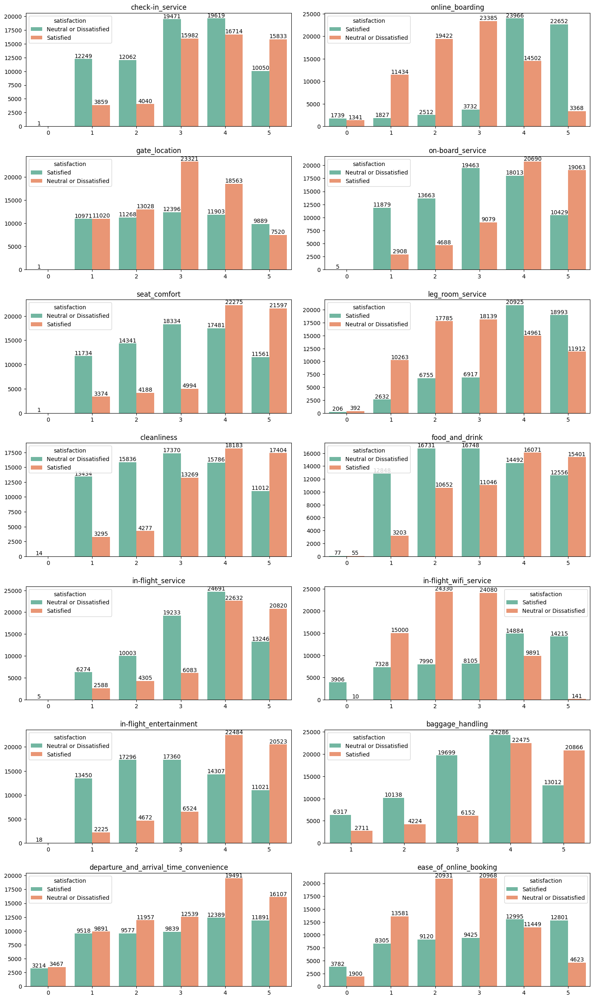

In [48]:
import matplotlib.pyplot as plt
import seaborn as sns

services_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling',
    'departure_and_arrival_time_convenience', # Added convenience column
    'ease_of_online_booking' # Added online booking column
]
plt.figure(figsize=(15, 25))

for index, col in enumerate(services_columns):
    plt.subplot((len(services_columns) + 1) // 2, 2, index + 1)

    graph = sns.countplot(x=col, data=df,hue="satisfaction", palette="Set2")

    # عرض القيم فوق كل شريط
    for container in graph.containers:
        graph.bar_label(container)

    plt.title(col)
    graph.set_xlabel("")
    graph.set_ylabel("")

plt.tight_layout(pad=2)
plt.show()

## 📊 Insights from Countplots (Bivariate Analysis)

- ✅ **High Ratings → Satisfaction**:  
  - Services like **Online Boarding, Seat Comfort, Leg Room, Cleanliness, On-board Service, In-flight Service, Entertainment, Baggage Handling**  
  - Passengers giving **4–5 ratings** are overwhelmingly **Satisfied**.  

- ❌ **Low Ratings → Dissatisfaction**:  
  - Passengers who gave **0–3 ratings** are mostly **Neutral/Dissatisfied**.  

- 📶 **In-flight Wifi Service = Pain Point**:  
  - Large share of **Neutral/Dissatisfied passengers** rate it **0–2**.  
  - Strong driver of dissatisfaction compared to other services.  

- ⚖️ **Check-in Service & Gate Location**:  
  - Ratings more evenly spread between groups.  
  - Important, but weaker predictors of satisfaction compared to comfort/amenities.  

- 🌐 **Ease of Online Booking**:  
  - Mostly positive (many **Satisfied passengers give 4–5**).  
  - Fewer extreme low ratings than Wi-Fi.  

- 🕒 **Departure & Arrival Time Convenience**:  
  - Ratings more **variable** in both groups.  
  - Impact on satisfaction may be more **nuanced**.  

➡️ **Key Takeaway**:  
Passenger satisfaction is most strongly tied to **in-flight services & comfort**.  
🚨 **In-flight Wifi Service** stands out as a **critical area for improvement**.  


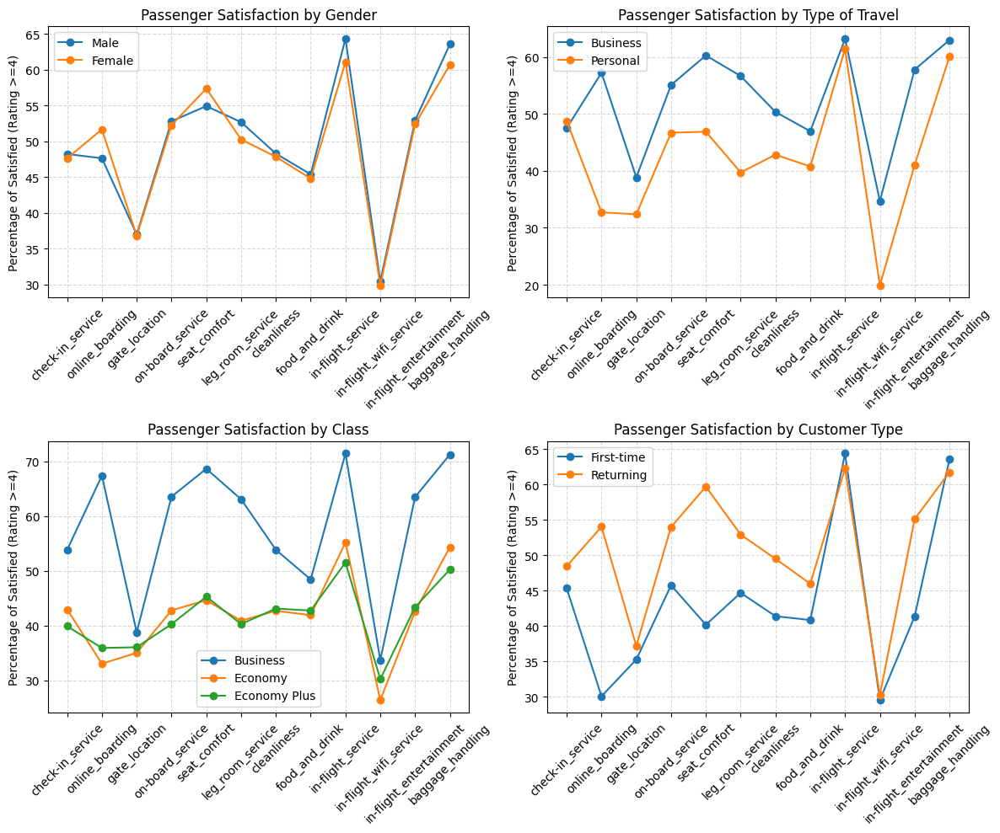

In [49]:
import matplotlib.pyplot as plt

service_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling'
]

# المجموعات المختلفة
groups = {
    'Gender': 'gender',
    'Type of Travel': 'type_of_travel',
    'Class': 'class',
    'Customer Type': 'customer_type'
}

plt.figure(figsize=(12,10))

for i, (group_name, col_name) in enumerate(groups.items(), 1):
    plt.subplot(2, 2, i)
    for val in df[col_name].unique():
        subset = df[df[col_name] == val]
        rates = []
        total_passengers = subset.shape[0]
        for service in service_columns:
            satisfied_count = subset[subset[service] >= 4].shape[0]
            rates.append(satisfied_count / total_passengers * 100)
        plt.plot(service_columns, rates, marker='o', label=val)
    plt.title(f'Passenger Satisfaction by {group_name}')
    plt.xticks(rotation=45)
    plt.ylabel('Percentage of Satisfied (Rating >=4)')
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.legend()

plt.tight_layout()
plt.show()


### 🔹 Insights from High Ratings (≥ 4) Across Passenger Groups  

The plots show the **percentage of passengers who gave a rating of 4 or higher** for each service, broken down by passenger groups.  

**1. Gender**  
- Male and Female passengers give **similar percentages of high ratings** across almost all services.  
- This confirms that **gender is not a strong factor** in determining service satisfaction.  

**2. Type of Travel**  
- ✈️ **Business travelers** consistently show a **higher percentage of high ratings** compared to Personal travelers.  
- This suggests business travelers are generally **more satisfied** or may have **different expectations** than personal travelers.  

**3. Class**  
- 💼 **Business Class** passengers report the **highest percentage of high ratings**, followed by Economy Plus, and then Economy.  
- This aligns with the expectation that higher classes provide a **better overall service experience**.  

**4. Customer Type**  
- 🔁 **Returning customers** tend to give **higher percentages of high ratings** than First-time customers.  
- This matches earlier findings that returning customers are **more satisfied** overall.  

**5. Service-Specific Trends**  
- 📶 *In-flight Wifi Service* consistently has the **lowest percentage of high ratings** across all groups → a clear weakness.  
- ✅ Services like *Online Boarding*, *In-flight Service*, and *Baggage Handling* maintain **high percentages of satisfaction** across most groups.  

**Summary**  
👉 **Type of Travel, Class, and Customer Type** play important roles in the likelihood of giving high service ratings.  
👉 **Gender differences are minimal**, but **In-flight Wifi Service** is a universal weak spot.  


In [50]:
# Define the list of service columns
service_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling'
]

# Filter the DataFrame for satisfied passengers
satisfied_df = df[df['satisfaction'] == 'Satisfied']

print("Total number of satisfied passengers who rated a service 4 or 5:")

# Calculate and display the count of satisfied passengers with ratings 4 or 5 for each service column
for col in service_columns:
    high_rating_count = satisfied_df[satisfied_df[col] >= 4][col].count()
    print(f"'{col}': {high_rating_count}")

Total number of satisfied passengers who rated a service 4 or 5:
'check-in_service': 32547
'online_boarding': 46618
'gate_location': 21792
'on-board_service': 39753
'seat_comfort': 43872
'leg_room_service': 39918
'cleanliness': 35587
'food_and_drink': 31472
'in-flight_service': 43452
'in-flight_wifi_service': 29099
'in-flight_entertainment': 43007
'baggage_handling': 43341


In [51]:
import pandas as pd
import plotly.express as px

# قائمة أعمدة الخدمات
service_columns = [
    'check-in_service', 'online_boarding', 'gate_location',
    'on-board_service', 'seat_comfort', 'leg_room_service', 'cleanliness',
    'food_and_drink', 'in-flight_service', 'in-flight_wifi_service',
    'in-flight_entertainment', 'baggage_handling'
]

# تصفية الركاب الراضين
satisfied_df = df[df['satisfaction'] == 'Satisfied']

# حساب عدد الركاب ذوي التقييم >=4 لكل خدمة
high_rating_counts = {col: satisfied_df[satisfied_df[col] >= 4][col].count()
                      for col in service_columns}

# تحويل القيم لـ DataFrame
high_rating_df = pd.DataFrame(list(high_rating_counts.items()),
                              columns=['Service', 'Count of Satisfied (Rating >= 4)'])

# ترتيب الأعمدة تنازليًا حسب العدد
high_rating_df = high_rating_df.sort_values(by='Count of Satisfied (Rating >= 4)', ascending=False)

# رسم الـ bar chart
fig = px.bar(high_rating_df, x='Service', y='Count of Satisfied (Rating >= 4)',
             title='Number of Satisfied Passengers with High Ratings (4 or 5) for Each Service')

fig.update_layout(xaxis_tickangle=-45)  # لتسهيل قراءة أسماء الخدمات
fig.show()


### Summary of Insights

- **Top Drivers of Satisfaction:** Online Boarding, Seat Comfort, In-flight Service, Baggage Handling, and Entertainment receive the most high ratings (4–5).  
- **Weak Areas:** Gate Location and In-flight Wifi Service get the fewest high ratings, even among satisfied passengers.  
- **Moderate Contributors:** Leg Room, On-board Service, Cleanliness, Check-in, and Food & Drink play a secondary role.  

➡️ Overall, the **boarding process and core in-flight experience** are the strongest contributors to passenger satisfaction.


<h2 align="center">🔀📊 Multivariate Analysis</h2>


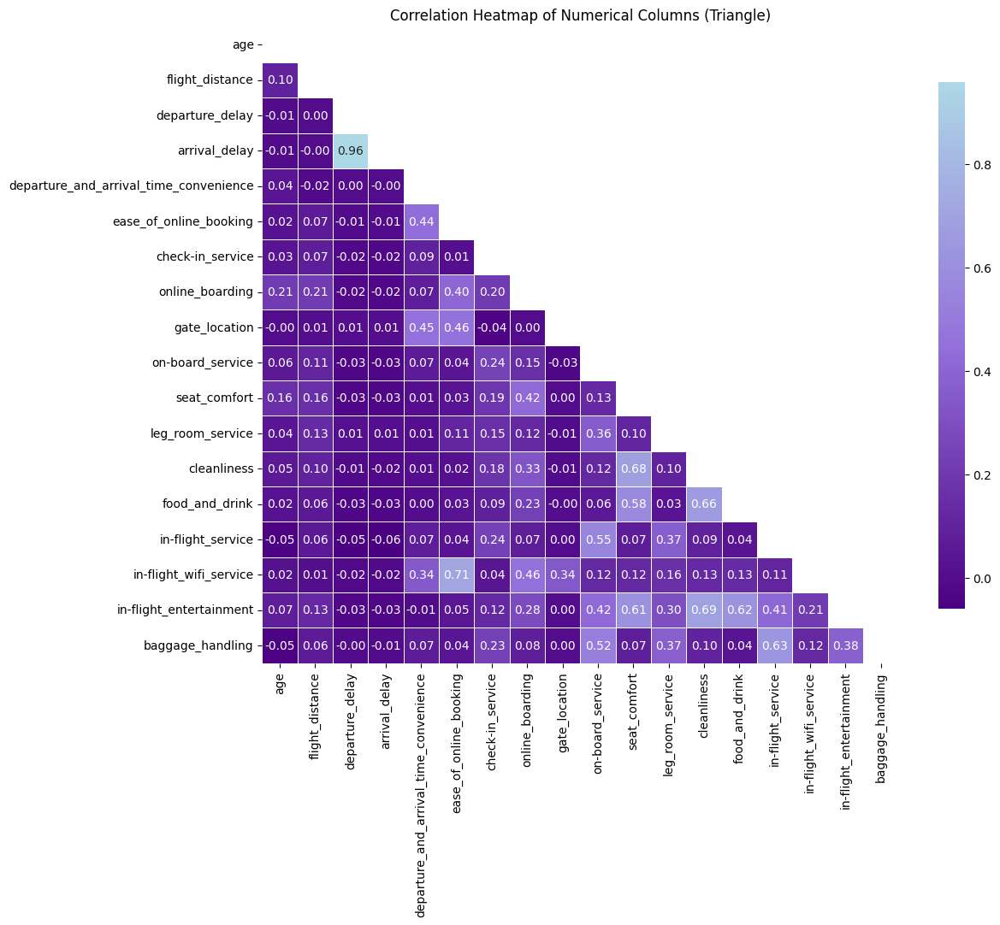

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

# Select only numerical columns for the correlation matrix
numerical_df = df.select_dtypes(include=np.number)

# Calculate the correlation matrix
correlation_matrix = numerical_df.corr()

colors = ["#4B0082", "#9370DB", "#ADD8E6"]
cmap = LinearSegmentedColormap.from_list("custom_purple_pink", colors, N=256)

# Create mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

plt.figure(figsize=(12, 10))
sns.heatmap(
    correlation_matrix,
    mask=mask,          # apply mask
    annot=True,
    cmap=cmap,
    fmt=".2f",
    square=True,        # مربعات متساوية
    linewidths=0.5,     # خطوط فاصلة بين الخانات
    cbar_kws={"shrink": .8}  # لتصغير ال colorbar
)
plt.title('Correlation Heatmap of Numerical Columns (Triangle)')
plt.show()


### 🔗 Insights from Correlation Analysis (Numerical Columns)

- **Strong Positive Correlations**:
  - **Departure Delay ↔ Arrival Delay (0.96):** Very strong correlation (expected) — flights that depart late almost always arrive late.
  - **Seat Comfort ↔ Food and Drink (0.58):** Passengers who rate seat comfort highly also tend to rate food and drink positively.
  - **Cleanliness ↔ Food and Drink (0.66):** Strong positive relationship between these two service ratings.
  - **In-flight Service ↔ Baggage Handling (0.63):** Moderately strong correlation.
  - **Online Boarding ↔ In-flight Wifi Service (0.46):** Moderate correlation.
  - **Ease of Online Booking ↔ In-flight Wifi Service (0.71):** Strong correlation, suggesting tech-savvy passengers value both.

- **Weak or No Significant Correlations**:
  - **Age** shows weak correlations with most other features.
  - **Flight Distance** has weak to moderate correlations with some service ratings, but not strongly tied.

📌 **Takeaway:**  
- The strong link between **Departure Delay and Arrival Delay** is intuitive.  
- Correlations among **service ratings** (e.g., Seat Comfort, Cleanliness, Food & Drink) suggest that improvements in one area may positively influence perceptions of others.  
- Tech-related aspects (**Online Booking, Wifi**) appear connected, pointing to the importance of a seamless digital experience.


--- Generating Faceted Plots: Distributions by Group ---

Age Distribution by Class:


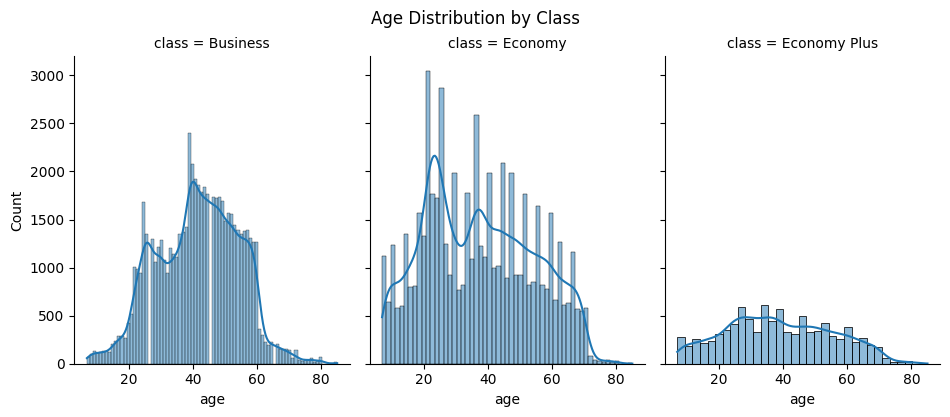


Age Distribution by Type of Travel:


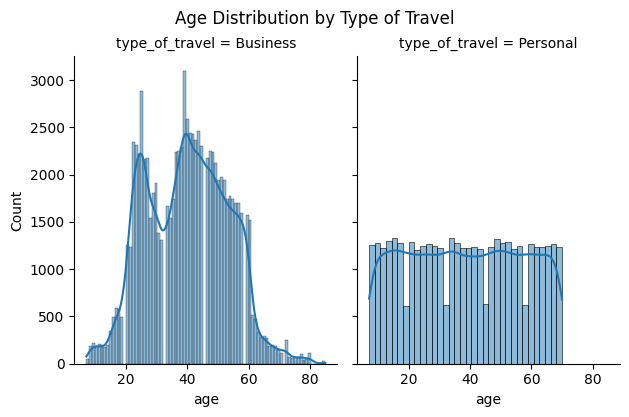


Flight Distance Distribution by Class:


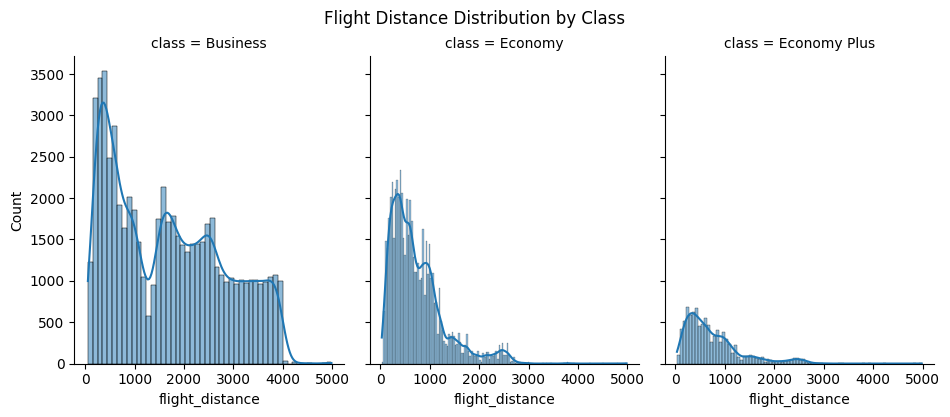


--- Generating Faceted Plots: Relationships by Group ---

Age vs. Flight Distance by Customer Type:


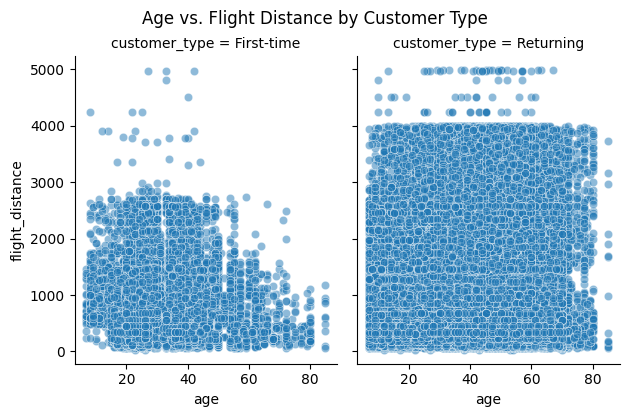


Age vs. Flight Distance by Type of Travel:


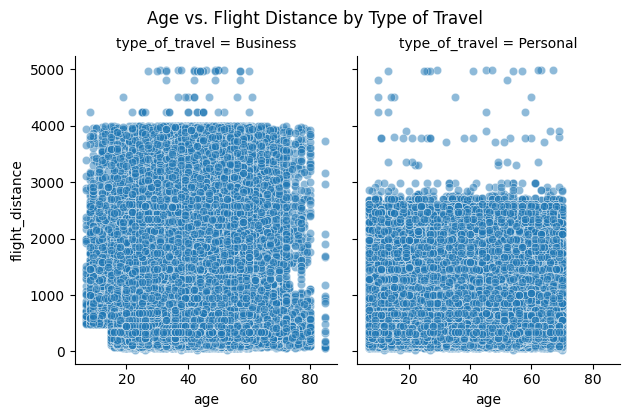

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# --- Faceted Plots: Distributions by Group ---

print("--- Generating Faceted Plots: Distributions by Group ---")

# Faceted Plot: Histograms of Age by Class
print("\nAge Distribution by Class:")
g = sns.FacetGrid(df, col="class", height=4, aspect=.8)
g.map(sns.histplot, "age", kde=True)
g.fig.suptitle('Age Distribution by Class', y=1.03)
plt.show()

# Faceted Plot: Histograms of Age by Type of Travel
print("\nAge Distribution by Type of Travel:")
g = sns.FacetGrid(df, col="type_of_travel", height=4, aspect=.8)
g.map(sns.histplot, "age", kde=True)
g.fig.suptitle('Age Distribution by Type of Travel', y=1.03)
plt.show()

# Faceted Plot: Histograms of Flight Distance by Class
print("\nFlight Distance Distribution by Class:")
g = sns.FacetGrid(df, col="class", height=4, aspect=.8)
g.map(sns.histplot, "flight_distance", kde=True)
g.fig.suptitle('Flight Distance Distribution by Class', y=1.03)
plt.show()


# --- Faceted Plots: Relationships between Variables by Group ---

print("\n--- Generating Faceted Plots: Relationships by Group ---")

# Faceted Plot: Scatter plot of Age vs. Flight Distance by Customer Type
print("\nAge vs. Flight Distance by Customer Type:")
g = sns.FacetGrid(df, col="customer_type", height=4, aspect=.8)
g.map(sns.scatterplot, "age", "flight_distance", alpha=0.5)
g.fig.suptitle('Age vs. Flight Distance by Customer Type', y=1.03)
plt.show()

# Faceted Plot: Scatter plot of Age vs. Flight Distance by Type of Travel
print("\nAge vs. Flight Distance by Type of Travel:")
g = sns.FacetGrid(df, col="type_of_travel", height=4, aspect=.8)
g.map(sns.scatterplot, "age", "flight_distance", alpha=0.5)
g.fig.suptitle('Age vs. Flight Distance by Type of Travel', y=1.03)
plt.show()


--- Generating Heatmaps for Categorical Relationships ---

Customer Type vs. Type of Travel Counts:


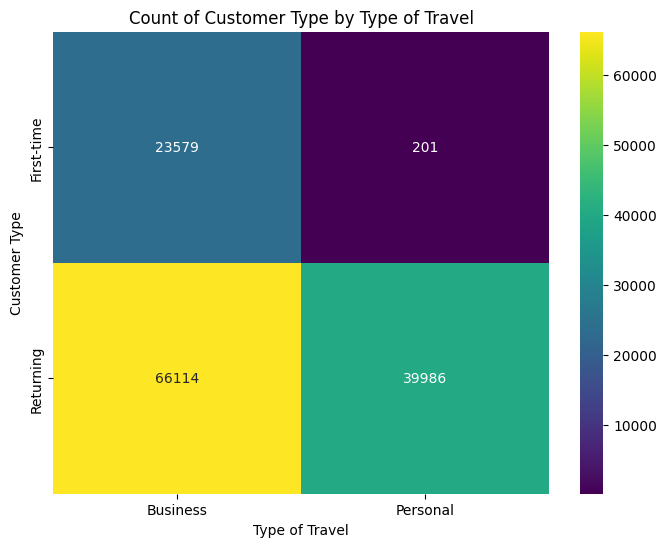


Class vs. Type of Travel Counts:


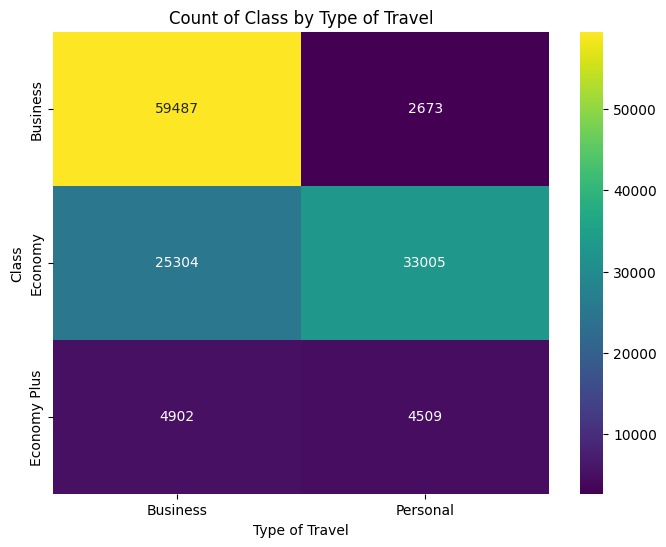


Class vs. Customer Type Counts:


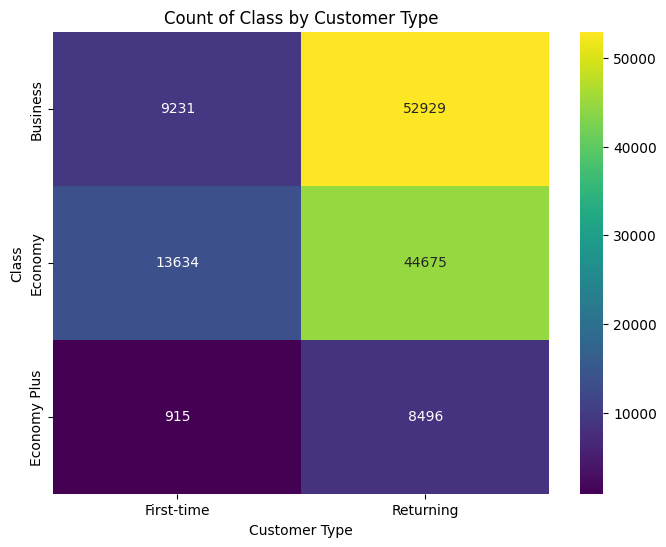

In [54]:
# --- Heatmaps for Categorical Relationships ---

print("\n--- Generating Heatmaps for Categorical Relationships ---")

# Heatmap: Customer Type vs. Type of Travel Counts
print("\nCustomer Type vs. Type of Travel Counts:")
crosstab_data_ct_tt = pd.crosstab(df['customer_type'], df['type_of_travel'])
plt.figure(figsize=(8, 6))
sns.heatmap(crosstab_data_ct_tt, annot=True, fmt='d', cmap='viridis')
plt.title('Count of Customer Type by Type of Travel')
plt.xlabel('Type of Travel')
plt.ylabel('Customer Type')
plt.show()

# Heatmap: Class vs. Type of Travel Counts
print("\nClass vs. Type of Travel Counts:")
crosstab_data_class_tt = pd.crosstab(df['class'], df['type_of_travel'])
plt.figure(figsize=(8, 6))
sns.heatmap(crosstab_data_class_tt, annot=True, fmt='d', cmap='viridis')
plt.title('Count of Class by Type of Travel')
plt.xlabel('Type of Travel')
plt.ylabel('Class')
plt.show()

# Heatmap: Class vs. Customer Type Counts
print("\nClass vs. Customer Type Counts:")
crosstab_data_class_ct = pd.crosstab(df['class'], df['customer_type'])
plt.figure(figsize=(8, 6))
sns.heatmap(crosstab_data_class_ct, annot=True, fmt='d', cmap='viridis')
plt.title('Count of Class by Customer Type')
plt.xlabel('Customer Type')
plt.ylabel('Class')
plt.show()

## 🔎 Multivariate Analysis

This section contains faceted plots and heatmaps that reveal relationships between different passenger attributes.

### 📊 Insights from Faceted Plots:
- **Age Distribution by Class and Type of Travel**  
  - Business Class and Economy Plus → more older passengers.  
  - Economy Class → more young adults.  
  - Business travelers → broader middle-age spread.  
  - Personal travelers → more uniform age distribution.  

- **Flight Distance Distribution by Class**  
  - Business Class → longer flights.  
  - Economy/Economy Plus → shorter flights.  

- **Age vs. Flight Distance by Customer Type and Travel Type**  
  - Returning customers & Business travelers → wider range of ages and longer flights.  
  - First-time customers & Personal travelers → shorter flights, mostly younger ages.  

### 🔥 Insights from Heatmaps:
- **Customer Type vs. Type of Travel** → Most Business travelers are Returning customers.  
- **Class vs. Type of Travel** → Business Class is mainly used by Business travelers; Personal travelers mostly fly Economy/Economy Plus.  
- **Class vs. Customer Type** → Returning customers dominate Business Class, while First-time customers are more common in Economy.  

### 📝 Overall Summary:
- **Business travel** = Returning customers + Business Class → older passengers, longer flights.  
- **Personal travel** = Economy/Economy Plus + mix of First-time/Returning → younger passengers, shorter flights.  

➡️ These insights help airlines tailor services and strategies to different passenger profiles.
